<a href="https://colab.research.google.com/github/bryantosin1/KUIS_ML1/blob/main/UTS_MachineLearning_BryanTosinSaputro_2141720220.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Nama : Bryan Tosin Saputro
##Kelas   : 3D / 13
##NIM     : 2141720220

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import os
import random
from sklearn.cluster import KMeans

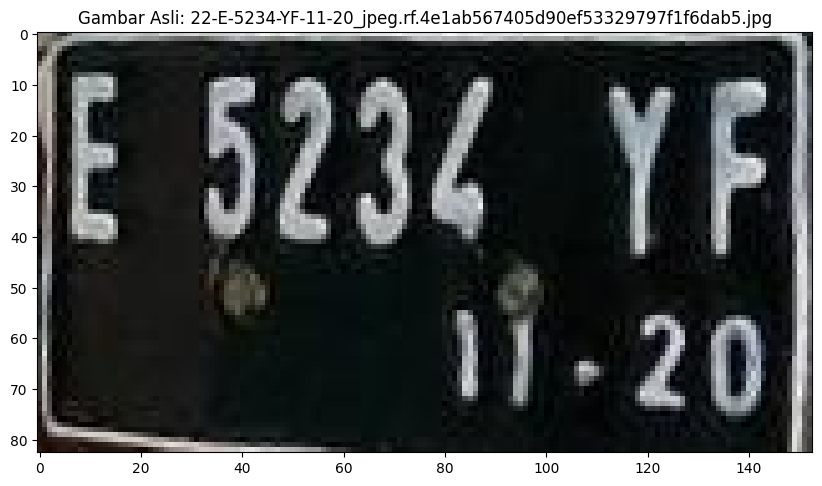

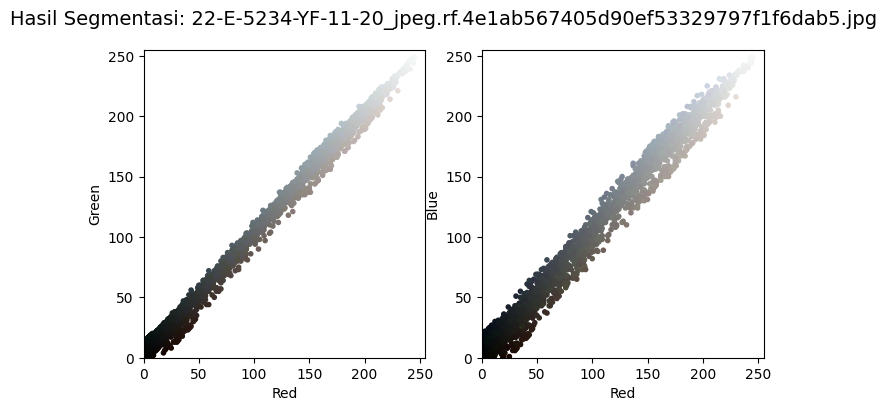

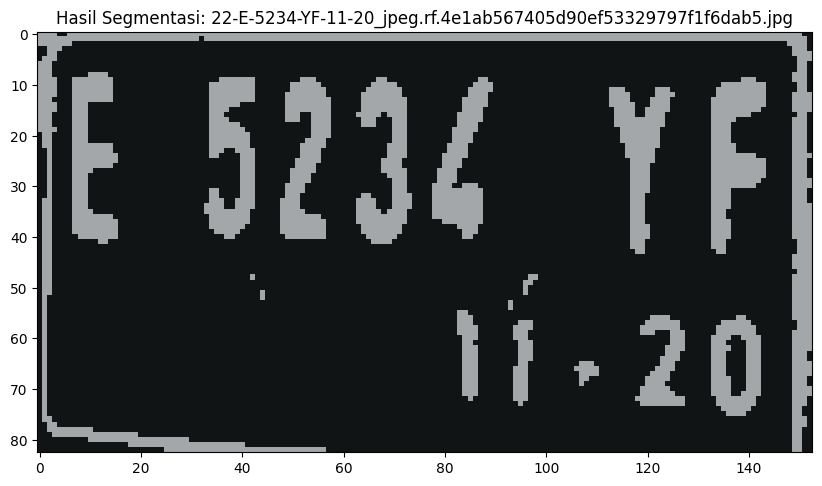

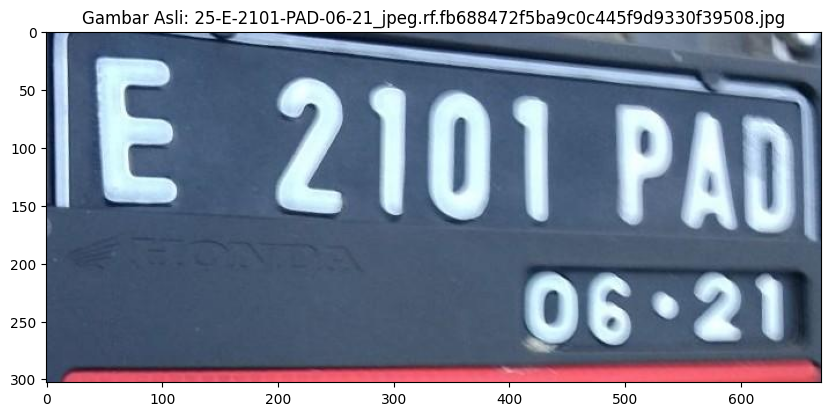

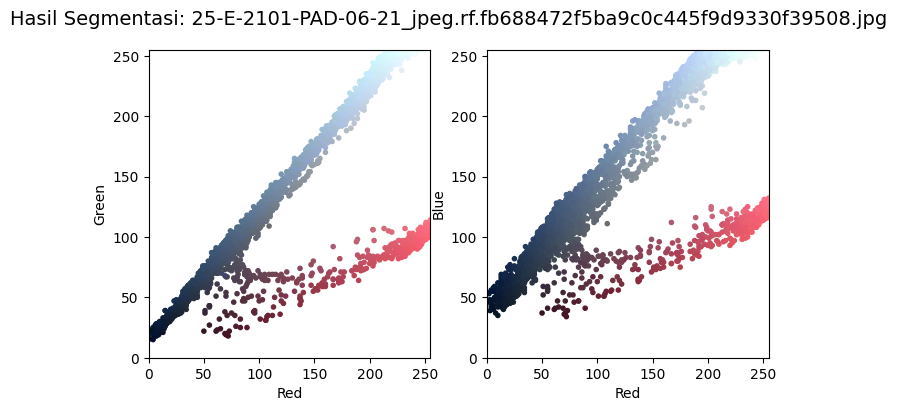

...

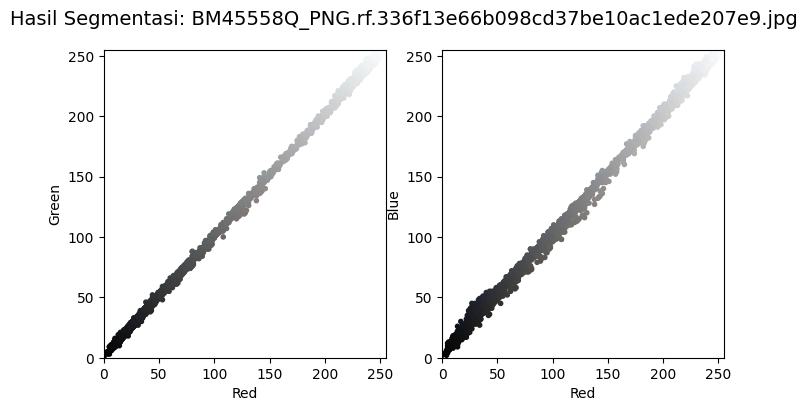

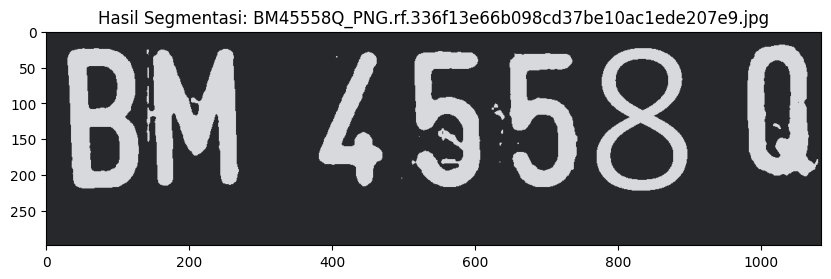

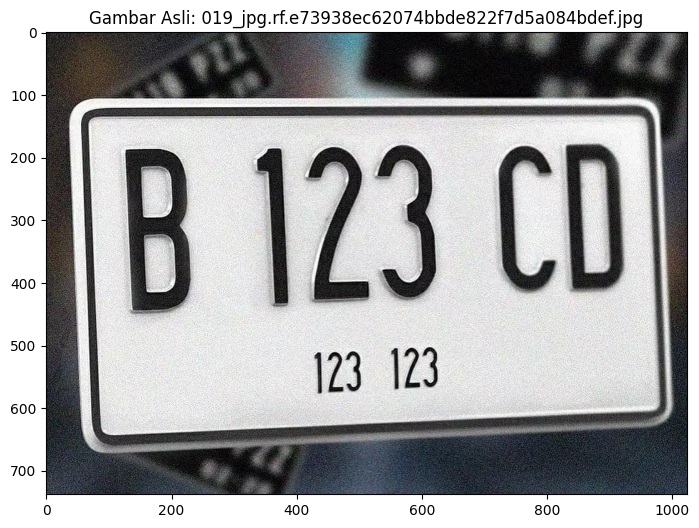

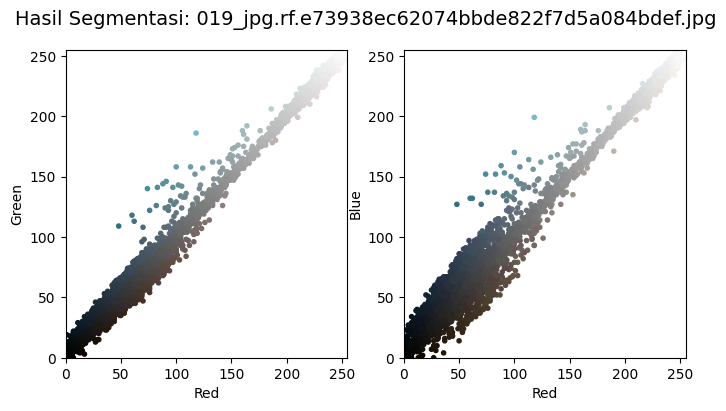

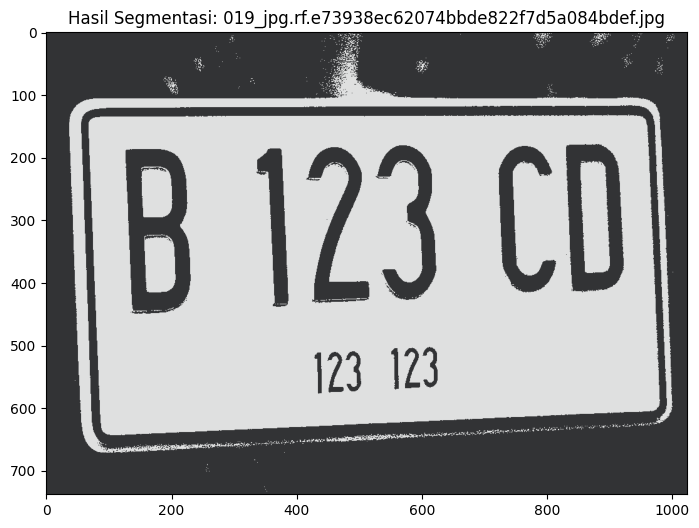

In [ ]:
# Fungsi untuk menggambar pixel
def plot_pixels(data, title, colors=None, N=10000):
    if colors is None:
        colors = data

    # Pilih subset data acak
    rng = np.random.RandomState(0)
    i = rng.permutation(data.shape[0])[:N]
    colors = colors[i]
    R, G, B = data[i].T

    fig, ax = plt.subplots(1, 2, figsize=(8, 4))
    ax[0].scatter(R, G, c=colors/255.0, marker='.')
    ax[0].set(xlabel='Red', ylabel='Green', xlim=(0, 255), ylim=(0, 255))

    ax[1].scatter(R, B, c=colors/255.0, marker='.')
    ax[1].set(xlabel='Red', ylabel='Blue', xlim=(0, 255), ylim=(0, 255))

    fig.suptitle(title, size=14)

# Jumlah cluster yang Anda inginkan
num_clusters = 2

# Variabel directory untuk menyimpan file gambar
directory = "/content/drive/MyDrive//dummy"

# Mengambil File dari variabel directory
image_files = [file for file in os.listdir(directory) if file.endswith(('.jpg', '.png'))]

# Mendefinisikan mode KMeans
kmeans = KMeans(n_clusters=num_clusters, random_state=0, n_init=1)

for i in range(len(image_files)):
    # Membaca file gambar
    img = cv2.imread(directory + "/" + image_files[i])
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    data = img_rgb.reshape((-1, 3))
    colors = data

    # Menampilkan gambar asli
    plt.figure(figsize=(10, 6))
    plt.imshow(img_rgb)
    plt.title('Gambar Asli: ' + image_files[i])
    plt.show()

    # Menampilkan gambar hasil segmentasi
    plot_pixels(data, title='Hasil Segmentasi: ' + image_files[i], colors=colors)
    plt.show()

    # Fit data ke model k-means
    kmeans.fit(data)

    # Mendapatkan nilai titik tengah dari setiap cluster
    cluster_centers = kmeans.cluster_centers_

    # Tambahkan inisialisasi new_colors
    new_colors = cluster_centers[kmeans.labels_].reshape(img.shape)

    # Menampilkan gambar hasil segmentasi
    plt.figure(figsize=(10, 6))
    plt.imshow(new_colors.astype(np.uint8))
    plt.title('Hasil Segmentasi: ' + image_files[i])
    plt.show()